<a href="https://colab.research.google.com/github/ShaswataRoy/ECE-695/blob/main/Homework%202/ECE695_Hw2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from PIL import Image
import PIL
im = Image.open("1.jpg")

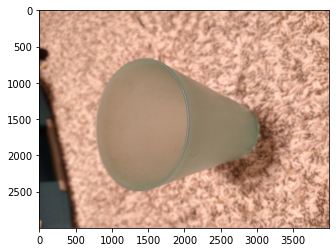

In [ ]:
import matplotlib.pyplot as plt
plt.imshow(im)

In [ ]:
 from torchvision import transforms
 
 convert = transforms.Compose([ transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5]) ])

In [ ]:
from typing import List

def RGB_hist(rgb_tensor: torch.Tensor)-> List[torch.Tensor]:
  r_tensor = rgb_tensor[0]
  g_tensor = rgb_tensor[1]
  b_tensor = rgb_tensor[2]
  
  hist_r = torch.histc(r_tensor, bins = 10, min = -1.0, max = 1.0)
  hist_g = torch.histc(g_tensor, bins = 10, min = -1.0, max = 1.0)
  hist_b = torch.histc(b_tensor, bins = 10, min = -1.0, max = 1.0)

  hist_r = hist_r.div(hist_r.sum())
  hist_g = hist_g.div(hist_g.sum())
  hist_b = hist_b.div(hist_b.sum())

  return [hist_r,hist_g,hist_b]

In [ ]:
import numpy as np
x = np.linspace(-1,0.8,10)

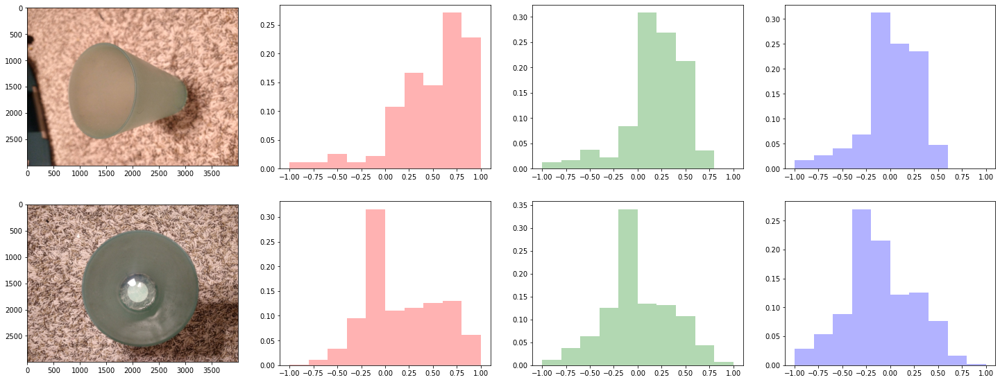

In [ ]:
plt.figure(figsize=(25,20))

histTensor = []
for i in range(1,3):
  im = Image.open(str(i)+".jpg")
  tensor_im = transforms.ToTensor()(im)
  tensor_im = convert(tensor_im)
  
  [hist_r,hist_g,hist_b] = RGB_hist(tensor_im)
  histTensor.append([hist_r,hist_g,hist_b])
  
  plt.subplot(4,4,4*i+1)
  plt.imshow(im)

  plt.subplot(4,4,4*i+2)
  plt.bar(x,hist_r,width=0.2,align='edge',color='r',alpha=0.3)

  plt.subplot(4,4,4*i+3)

  plt.bar(x,hist_g,width=0.2,align='edge',color='g',alpha=0.3)

  plt.subplot(4,4,4*i+4)

  plt.bar(x,hist_b,width=0.2,align='edge',color='b',alpha=0.3)

In [ ]:
from scipy.stats import wasserstein_distance

for ch in range(3):
  dist = wasserstein_distance( torch.squeeze( histTensor[0][ch] ).cpu().numpy(),torch.squeeze( histTensor[1][ch] ).cpu().numpy() )
  print("\n Wasserstein distance for channel: ", dist)


 Wasserstein distance for channel:  0.03561343118781224

 Wasserstein distance for channel:  0.04343476868234575

 Wasserstein distance for channel:  0.03745729766488354


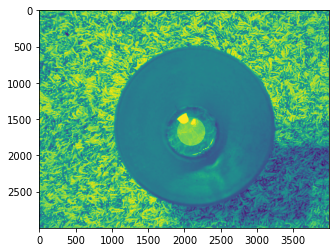

In [ ]:
plt.imshow(tensor_im[0])

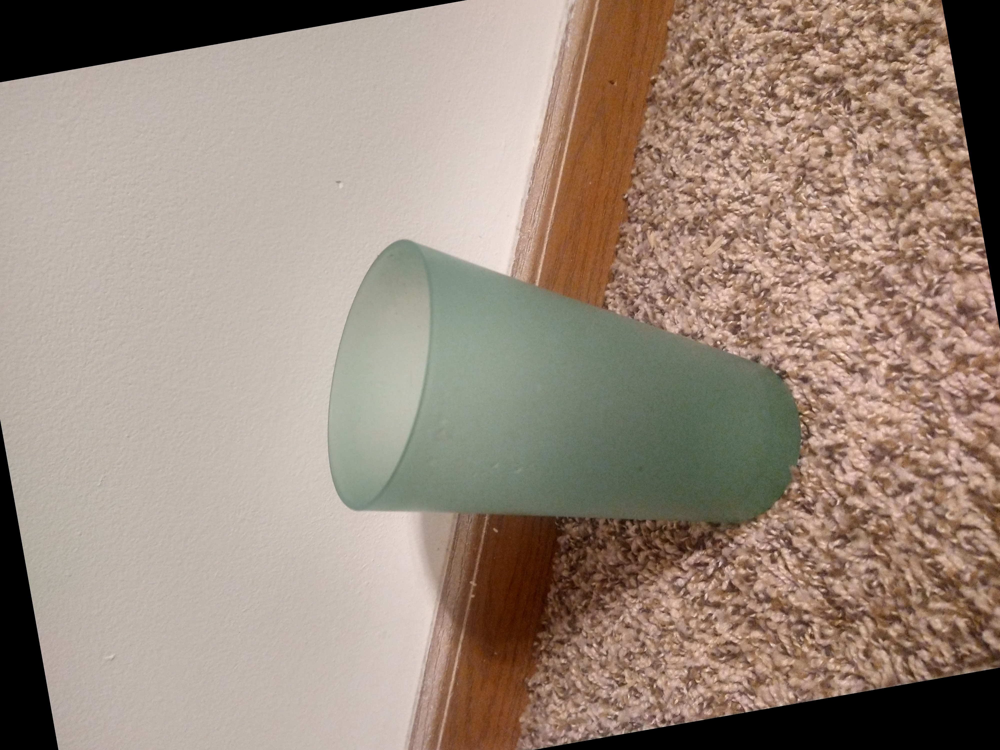

<Figure size 576x432 with 0 Axes>

In [ ]:
import torchvision.transforms.functional as TF

affine_transformer = TF.affine(im,angle=10,translate=(0.,0.),scale=1.,shear=0.,fill=0)
affine_transformer

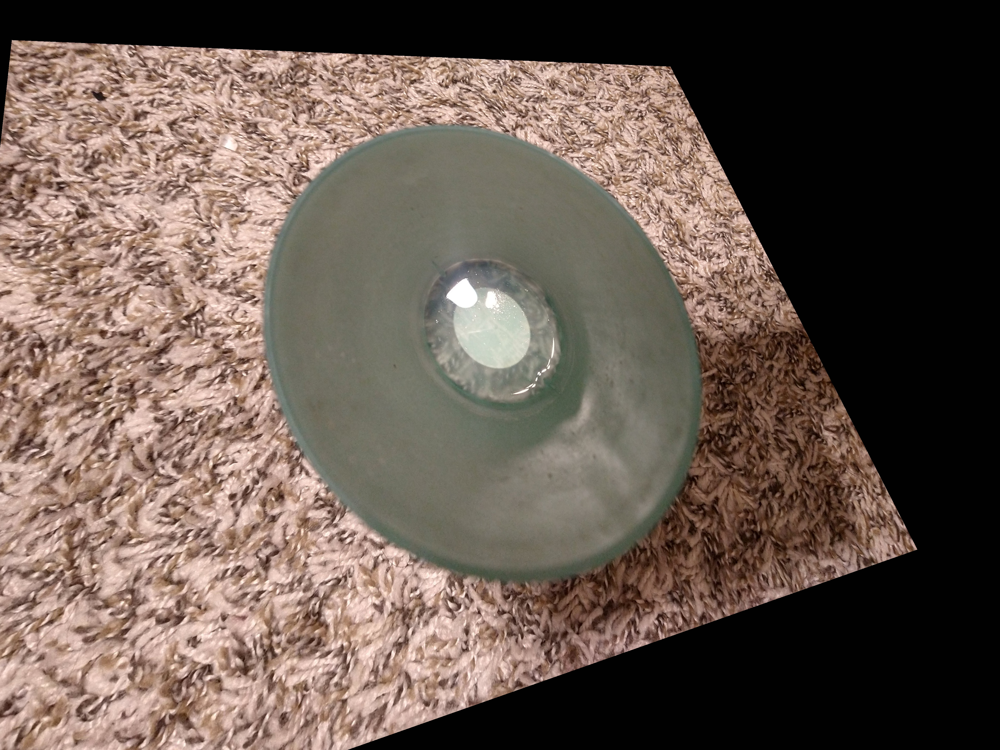

In [ ]:
tensor_im

In [ ]:
from google.colab import drive
drive.mount('/content/drive')